# Self-Driving Car Engineer Nanodegree


## Project: **Finding Lane Lines on the Road**

## Import Packages

In [1]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import numpy as np
import cv2

# Import everything needed to edit/save/watch video clips
from moviepy.editor import VideoFileClip
from IPython.display import HTML
%matplotlib inline

Additionally, let's define the following helper function which will allow us to show images side to side.

In [2]:
def show_side_to_side(images_and_titles):
    cols = len(images_and_titles)
    fig = plt.figure(figsize=(50, 50))
    for i, (img, title) in enumerate(images_and_titles):
        subplot = fig.add_subplot(1, cols, i + 1)
        subplot.title.set_text(title)

        options = {}
        if len(img.shape) < 3:
            options['cmap'] = 'gray'
        plt.imshow(img, **options)

    plt.show()

## Finding corners

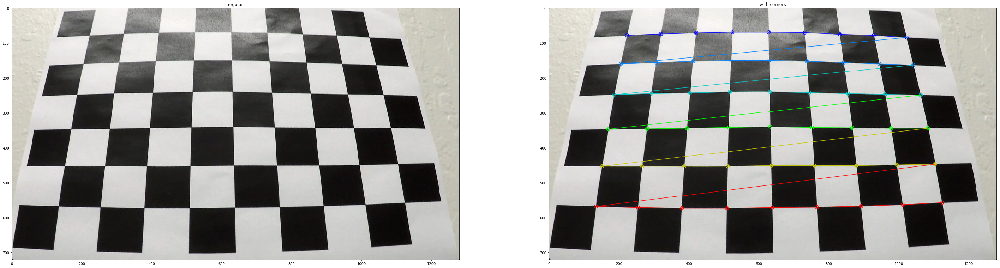

In [3]:
import glob
from typing import Tuple

class Error(Exception):
    pass

def to_gray(img: np.array) -> np.array:
    return cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)

def get_object_points(nx: int, ny: int) -> np.array:
    """Returns a set of object points like (0,0,0), (1,0,0), (2,0,0) ....,(nx,ny,0)."""
    objp = np.zeros((nx * ny, 3), np.float32)
    # np.mgrid returns a list of two matrices like:
    # 0 0 ... 0
    # 1 1 ... 1
    # ...
    # (nx - 1) (nx - 1) ... (nx - 1)
    # and
    # 0 1 ... (ny - 1)
    # 0 1 ... (ny - 1)
    # ...
    # 0 1 ... (ny - 1)
    #
    # The transponse converts the matrix into a list like:
    # [
    #  [[0, 0], [1, 0], ..., [nx - 1, 0]],
    #  [[0, 1], [1, 1], ..., [nx - 1, 1]],
    #  ...
    #  [[0, ny - 1], [1, ny - 1], ..., [nx - 1, ny - 1]]
    # ]
    #
    # reshape just flattens all elements into a single list of two elements each.
    # -1 means that the number of rows is to determined.
    objp[:, :2] = np.mgrid[0:nx, 0:ny].T.reshape(-1, 2)
    return objp

def find_corners(img: np.array, nx: int=9, ny: int=6) -> Tuple[bool, np.array]:
    """Finds the corners in a chess board image."""
    gray = to_gray(img)

    ret, corners = cv2.findChessboardCorners(gray, (nx, ny), None)
    if ret:
        # Refine the retrieved corners.
        criteria = (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 30, 0.001)
        refined_corners = cv2.cornerSubPix(gray, corners, winSize=(11,11), zeroZone=(-1,-1), criteria=criteria)
        return ret, refined_corners

    return False, None

def run_find_corners_example(img: np.array, nx: int=9, ny: int=6) -> None:
    ret, corners = find_corners(img, nx=nx, ny=ny)
    if not ret:
        raise Error("No corners detected.")

    corners_img = np.copy(img)
    cv2.drawChessboardCorners(corners_img, (nx, ny), corners, ret)
    show_side_to_side([(img, 'regular'), (corners_img, 'with corners')])

run_find_corners_example(plt.imread('camera_cal/calibration3.jpg'))

## Calibrating the camera

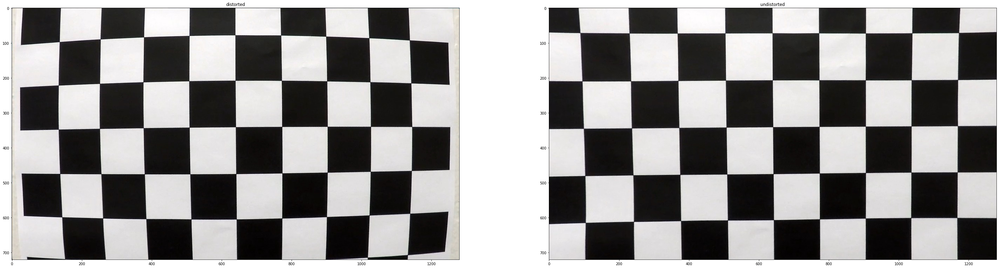

In [4]:
import os

def calibrate_camera(input_dir: str, nx=9, ny=6) -> Tuple[np.array, np.array]:
    """Calibrates the camera based on a set of chess board images.
    
    Returns the camera matrix and the distortion coefficients as a tuple.
    """
    # Implementation based on https://opencv-python-tutroals.readthedocs.io/en/latest/py_tutorials/py_calib3d/py_calibration/py_calibration.html

    # Arrays to store object points and image points from all the images so we can
    # calibrate the camera.
    objpoints = [] # 3d point in real world space
    imgpoints = [] # 2d points in image plane.

    # prepare object points, like (0,0,0), (1,0,0), (2,0,0) ....,(nx - 1,ny - 1,0)
    objp = get_object_points(nx, ny)

    image_filepaths = glob.glob(os.path.join(input_dir, '*.jpg'))
    gray_shape = None
    for i, filepath in enumerate(image_filepaths):
        img = plt.imread(filepath)
        inverse_gray_shape = img.shape[::-1][1:]
        ret, corners = find_corners(img, nx=nx, ny=ny)
        if not ret:
            continue

        objpoints.append(objp)
        imgpoints.append(corners)

    ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, inverse_gray_shape, None, None)
    if not ret:
        raise Error("Unsuccessful calibration.")

    return mtx, dist

def undistort(img: np.array, mtx: np.array, dist: np.array) -> np.array:
    """Undistort a single image."""
    return cv2.undistort(img, mtx, dist, None, mtx)

def run_calibration_example(img: np.array, mtx: np.array, dist: np.array) -> None:
    undistorted_img = undistort(img, mtx, dist)
    show_side_to_side([(img, 'distorted'), (undistorted_img, 'undistorted')])

calibration_mtx, distortion_coefficients = calibrate_camera('camera_cal')
run_calibration_example(plt.imread('camera_cal/calibration1.jpg'), calibration_mtx, distortion_coefficients)

## Undistorting images

This image is: <class 'numpy.ndarray'> with dimensions: (720, 1280, 3)


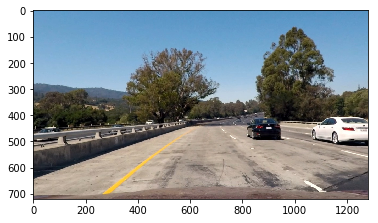

In [5]:
image = plt.imread('test_images/test1.jpg')

undistorted_image = undistort(image, calibration_mtx, distortion_coefficients)
print('This image is:', type(undistorted_image), 'with dimensions:', undistorted_image.shape)
plt.imshow(undistorted_image)

## Sobel

The [Sobel operator](https://en.wikipedia.org/wiki/Sobel_operator) is used as a way o taking the derivate of an image in the x or y direction.

### Some useful Sobel related functions

In [6]:
from collections import namedtuple
import enum

class Orient(enum.Enum):
    X = enum.auto()
    Y = enum.auto()

def apply_sobel(gray: np.array, orient: Orient, sobel_kernel: int=3):
    """Calculates the gradient of the given gray image in the specified orientation."""
    x, y = 1, 0
    if orient == Orient.Y:
        x, y = 0, 1
    return cv2.Sobel(gray, cv2.CV_64F, x, y, ksize=sobel_kernel)

def normalize(sobel: np.array) -> np.array:
    """Normalizes a sobel matrix to the range [0, 255]."""
    return np.uint8(255 * sobel / np.max(sobel))    

Bounds = namedtuple('Bounds', ['lower_bound', 'upper_bound'])

def get_mask(img: np.array, bounds: Bounds) -> np.array:
    """Returns the pixels within the specified bounds."""
    return cv2.inRange(img, bounds.lower_bound, bounds.upper_bound)

def apply_mask(img: np.array, mask: np.array) -> np.array:
    return cv2.bitwise_and(img, img, mask=mask)

def get_abs_sobel_mask(gray: np.array, orient: Orient, bounds: Bounds, sobel_kernel: int=3) -> np.array:
    """Returns a normalized absolute Sobel mask in the specified orientation, and within the specified bounds."""
    sobel = apply_sobel(gray, orient=orient, sobel_kernel=sobel_kernel)
    return get_mask(normalize(np.absolute(sobel)), bounds)

### Sobel X

When we apply the Sobel operator in the x direction, we are emphasizing edges closer to vertical.

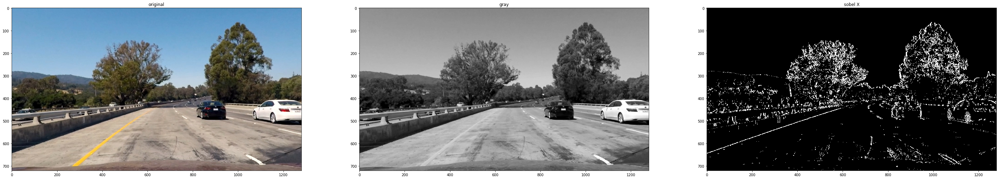

In [7]:
def get_sobel_x_mask(gray: np.array) -> np.array:
    """Returns a Sobel mask on the x axis."""
    return get_abs_sobel_mask(gray, Orient.X, Bounds(20, 100))

def run_sobel_x_example(img: np.array):
    gray = to_gray(img)
    sobelx_img = get_sobel_x_mask(gray)
    show_side_to_side([(img, 'original'), (gray, 'gray'), (sobelx_img, 'sobel X')])

run_sobel_x_example(undistorted_image)

### Sobel Y

Similarly to the Sobel operation on the y direction, applying the Sobel operator in the y direction emphasizes edges closer to horizontal.

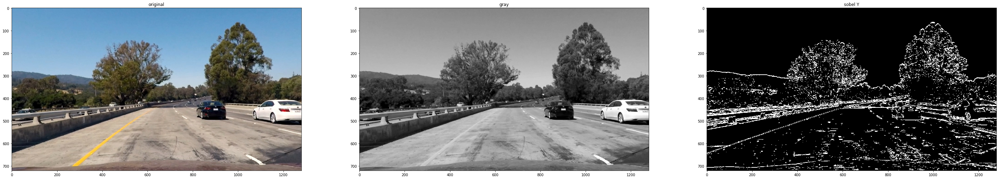

In [8]:
def get_sobel_y_mask(gray: np.array) -> np.array:
    """Returns a Sobel mask on the y axis."""
    return get_abs_sobel_mask(gray, Orient.Y, Bounds(20, 100))

def run_sobel_y_example(img: np.array):
    gray = to_gray(img)
    sobely_img = get_sobel_y_mask(gray)
    show_side_to_side([(img, 'original'), (gray, 'gray'), (sobely_img, 'sobel Y')])

run_sobel_y_example(undistorted_image)

### Sobel XY

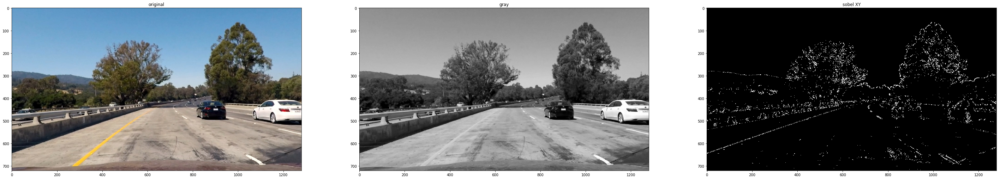

In [9]:
def get_sobel_xy_mask(gray: np.array) -> np.array:
    """Returns a combined Sobel X and Sobel Y mask."""
    maskx = get_sobel_x_mask(gray)
    masky = get_sobel_y_mask(gray)
    return cv2.bitwise_and(maskx, masky)

def run_sobel_xy_example(img: np.array):
    gray = to_gray(img)
    sobelxy_img = get_sobel_xy_mask(gray)
    show_side_to_side([(img, 'original'), (gray, 'gray'), (sobelxy_img, 'sobel XY')])

run_sobel_xy_example(undistorted_image)

As you can see, Sobel X and Sobel Y focus on different sets of lines. So, if we want to get an accurate representation of the edges in our image, we have to use a combination of both.

### Sobel magnitude

The Sobel magnitude operator calculates the magnitude of the gradient at each point. In other words, that represents how much the gradient is changing in the X and Y direction.

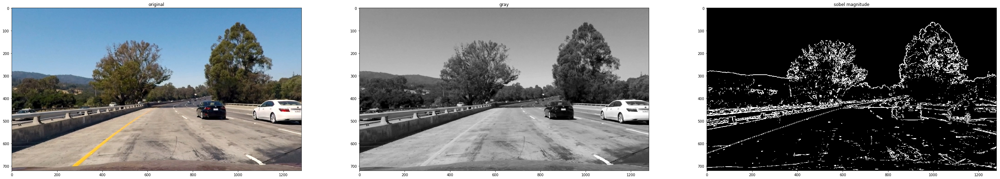

In [10]:
def get_magnitude_sobel_mask(gray: np.array, bounds: Bounds=Bounds(30, 100), sobel_kernel: int=3) -> np.array:
    """Returns a mask for the magnitude of the Sobol X and Y transformations."""
    sobelx = apply_sobel(gray, Orient.X, sobel_kernel=sobel_kernel)
    sobely = apply_sobel(gray, Orient.Y, sobel_kernel=sobel_kernel)
    magnitude = np.sqrt(np.square(sobelx) + np.square(sobely))
    return get_mask(normalize(magnitude), bounds)

def run_magnitude_example(img: np.array):
    gray = to_gray(img)
    sobelm_img = get_magnitude_sobel_mask(gray)
    show_side_to_side([(img, 'original'), (gray, 'gray'), (sobelm_img, 'sobel magnitude')])

run_magnitude_example(undistorted_image)

### Sobel direction

The Sobel direction operator returns a rought estimate of what is the direction of the gradient at each point.

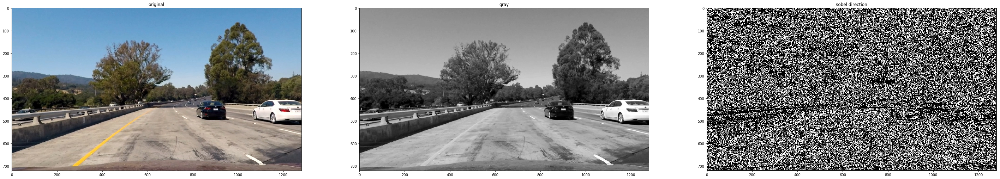

In [11]:
def get_direction_sobel_mask(gray: np.array, bounds: Bounds=Bounds(0.7, 1.3), sobel_kernel=3) -> np.array:
    """Returns a mask for the direction of the Sobol X and Y transformations."""
    sobelx = np.absolute(apply_sobel(gray, Orient.X, sobel_kernel=sobel_kernel))
    sobely = np.absolute(apply_sobel(gray, Orient.Y, sobel_kernel=sobel_kernel))
    direction = np.arctan2(sobely, sobelx)
    return get_mask(direction, bounds)

def run_direction_example(img: np.array):
    gray = to_gray(img)
    sobeld_img = get_direction_sobel_mask(gray)
    show_side_to_side([(img, 'original'), (gray, 'gray'), (sobeld_img, 'sobel direction')])

run_direction_example(undistorted_image)

### Sobel magnitude and direction

Combining the Sobel magnitude and the Sobel direction operations we can get an estimate of the edges in the image and their angle. In our particular case, we want to avoid very flat horizontal or vertical lines.

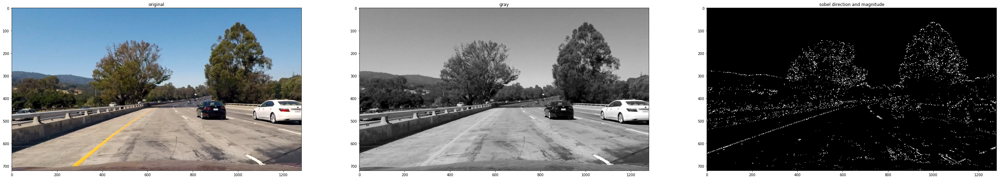

In [12]:
def get_direction_and_magnitude_sobel_mask(gray: np.array) -> np.array:
    """Returns a combined Sobel magnitude and Sobel direction mask."""
    maskm = get_magnitude_sobel_mask(gray)
    maskd = get_direction_sobel_mask(gray)
    return cv2.bitwise_and(maskm, maskd)

def run_direction_and_magnitude_example(img: np.array):
    gray = to_gray(img)
    sobeldm_img = get_direction_and_magnitude_sobel_mask(gray)
    show_side_to_side([(img, 'original'), (gray, 'gray'), (sobeldm_img, 'sobel direction and magnitude')])

run_direction_and_magnitude_example(undistorted_image)

### All Sobel masks

All these Sobol masks are capturing different pixels in our image. So, let's combine them together.

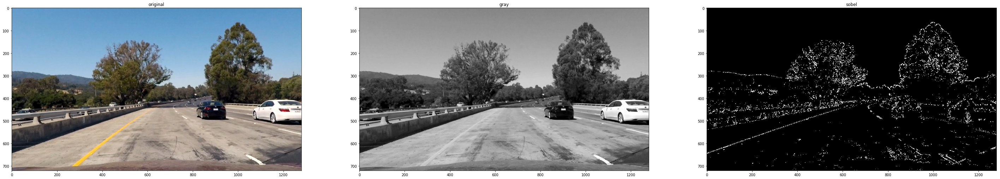

In [13]:
def get_all_sobel_masks(img: np.array, sobel_kernel: int=3) -> np.array:
    """Returns a combined mask for all Sobel calculations."""
    gray = to_gray(img)
    maskxy = get_sobel_xy_mask(gray)
    maskdm = get_direction_and_magnitude_sobel_mask(gray)

    return cv2.bitwise_or(maskxy, maskdm)

def run_all_sobel_masks_example(img: np.array):
    sobel_img = get_all_sobel_masks(img)
    show_side_to_side([(img, 'original'), (to_gray(img), 'gray'), (sobel_img, 'sobel')])

run_all_sobel_masks_example(undistorted_image)

As you can see, Sobel is good at detecting the edges of objects in an image. It's worth mentioning that Sobel is not detecting the yellow lane on the left. That's because Sobel operates on gray images, where we lose a lot of information.

## Color spaces

### [RGB](https://en.wikipedia.org/wiki/RGB_color_model)

This is the color space we are reading the image in.

### [HSV](https://en.wikipedia.org/wiki/HSL_and_HSV)

Is important to notice that during the RGB to HSV conversion process, some scaling happens ([more information](https://docs.opencv.org/2.4/modules/imgproc/doc/miscellaneous_transformations.html?#cvtcolor)). Therefore, the range of values we operate on are:
* H ∈ [0, 180]
* S ∈ [0, 255]
* V ∈ [0, 255]

Additionally, we used [this color picker](https://alloyui.com/examples/color-picker/hsv) to find the HSV values for some colors like white or yellow.

### [HSL](https://en.wikipedia.org/wiki/HSL_and_HSV)

Similarly to HSV, some scaling happens in the RGB to HSL conversion process. But another important detail is that opencv switches the order of saturation and lightness; so we are actually dealing with a HLS color space.

The range of values we operate on are:
* H ∈ [0, 180]
* L ∈ [0, 255]
* S ∈ [0, 255]

Additionally, we used [this color picker](https://www.w3schools.com/colors/colors_hsl.asp) to find the HSL values for some colors like white or yellow.

### Some useful transformation functions

In [14]:
def to_hsv(img: np.array) -> np.array:
    return cv2.cvtColor(img, cv2.COLOR_RGB2HSV)

def to_hsl(img: np.array) -> np.array:
    return cv2.cvtColor(img, cv2.COLOR_RGB2HLS)

## Yellow pixels
In order to improve the accuracy of our pipeline, we are going to detect yellow pixels that may belong to the left lane.

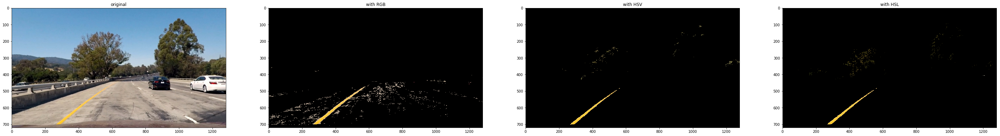

In [15]:
def get_yellow_rgb_mask(img: np.array, bounds: Bounds=Bounds(np.uint8([180, 50, 0]), np.uint8([255, 255, 150]))) -> np.array:
    # The RGB range for the color yellow was calculated using an standard color picker.
    return get_mask(img, bounds)

def get_yellow_hsv_mask(img: np.array, bounds: Bounds=Bounds(np.uint8([20, 100, 100]), np.uint8([40, 255, 255]))) -> np.array:
    # From https://docs.opencv.org/3.2.0/df/d9d/tutorial_py_colorspaces.html
    # Yellow is detected as:
    # lower bound: [h - 10, 100, 100]
    # upper bound: [h + 10, 255, 255]
    # where:
    #  yellow_rgb = np.uint8([[[255, 255, 0]]])
    #  h = cv2.cvtColor(yellow_rgb, cv2.COLOR_RGB2HSV)[0][0][0]
    #  h == 30
    return get_mask(to_hsv(img), bounds)

def get_yellow_hsl_mask(img: np.array, bounds: Bounds=Bounds(np.uint8([20, 30, 120]), np.uint8([35, 230, 255]))) -> np.array:
    # We used https://www.w3schools.com/colors/colors_hsl.asp to find a decent bound for
    # detecting color yellow.
    return get_mask(to_hsl(img), bounds)

def run_yellow_mask_example(img: np.array):
    rgb_yellow_img = apply_mask(img, get_yellow_rgb_mask(img))
    hsv_yellow_img = apply_mask(img, get_yellow_hsv_mask(img))
    hsl_yellow_img = apply_mask(img, get_yellow_hsl_mask(img))
    show_side_to_side([(img, 'original'), (rgb_yellow_img, 'with RGB'), (hsv_yellow_img, 'with HSV'), (hsl_yellow_img, 'with HSL')])

run_yellow_mask_example(undistorted_image)

As you can see, HSV and HSL are both doing a good job of detecting the yellow lane. However, we are going to use **HSV** because it was easier to tune for the yellow color.

## White pixels
Similarly to yellow pixels, we are going to detect white pixels that may belong to any lane.

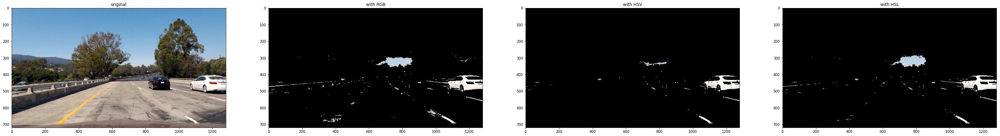

In [16]:
def get_white_rgb_mask(img: np.array, bounds: Bounds=Bounds(np.uint8([180, 180, 180]), np.uint8([255, 255, 255]))) -> np.array:
    # The RGB range for the color white was calculated using an standard color picker.
    return get_mask(img, bounds)

def get_white_hsv_mask(img: np.array, bounds: Bounds=Bounds(np.uint8([0, 0, 220]), np.uint8([255, 35, 255]))) -> np.array:
    # We used https://alloyui.com/examples/color-picker/hsv to find a decent bound for
    # detecting color white.
    return get_mask(to_hsv(img), bounds)

def get_white_hsl_mask(img: np.array, bounds: Bounds=Bounds(np.uint8([0, 200, 0]), np.uint8([180, 255, 255]))) -> np.array:
    # We only care about high lightness in this case.
    # Due to the fact that opencv stores the colors as HLS, the lightness value is specified
    # as the second parameter of the bounds variable.
    return get_mask(to_hsl(img), bounds)

def run_white_mask_example(img: np.array):
    rgb_white_img = apply_mask(img, get_white_rgb_mask(img))
    hsv_white_img = apply_mask(img, get_white_hsv_mask(img))
    hsl_white_img = apply_mask(img, get_white_hsl_mask(img))
    show_side_to_side([(img, 'original'), (rgb_white_img, 'with RGB'), (hsv_white_img, 'with HSV'), (hsl_white_img, 'with HSL')])

run_white_mask_example(undistorted_image)

As you can see, all color spaces are good at determining white pixels. However, we are going to choose **HLS** since it was really easy to tune.

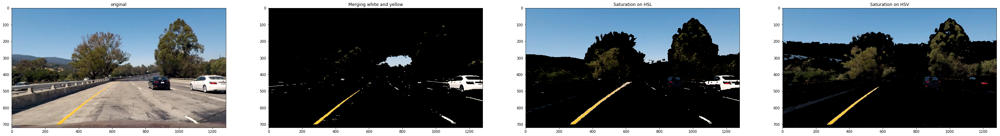

In [17]:
def get_white_and_yellow_mask(img: np.array) -> np.array:
    """Returns a combined white and yellow mask."""
    maskw = get_white_hsl_mask(img)
    masky = get_yellow_hsv_mask(img)
    return cv2.bitwise_or(maskw, masky)

def run_white_and_yellow_mask_example(img: np.array):
    white_and_yellow_img = apply_mask(img, get_white_and_yellow_mask(img))
    saturated_hsl_white_and_yellow_img = apply_mask(img, get_mask(to_hsl(img), Bounds(np.array([0, 0, 90]), np.array([180, 255, 255]))))
    saturated_hsv_white_and_yellow_img = apply_mask(img, get_mask(to_hsv(img), Bounds(np.array([0, 90, 0]), np.array([180, 255, 255]))))
    show_side_to_side([(img, 'original'), (white_and_yellow_img, 'Merging white and yellow'), (saturated_hsl_white_and_yellow_img, 'Saturation on HSL'), (saturated_hsv_white_and_yellow_img, 'Saturation on HSV')])

run_white_and_yellow_mask_example(undistorted_image)

Merging the white and yellow masks (2nd image) give us good results. However, we do a better job of detecting white and yellow lanes by using the saturation channel in the HSL color space (third image). Although, the HSL mask also detects the entire sky, we can solve that problem by selecting a region of interest. Therefore, we are going to go for **HSL** for detecting white and yellow pixels using the saturation channel.

In [18]:
def get_color_mask(img: np.array, bounds: Bounds=Bounds(np.array([0, 0, 90]), np.array([180, 255, 255]))) -> np.array:
    """Returns a mask that detects a significant portion of the white and yellow lanes."""
    return get_mask(to_hsl(img), bounds)

## Combine Sobel and color masks
We see a better accuracy in our detection if we merge together the Sobel mask and the color mask.

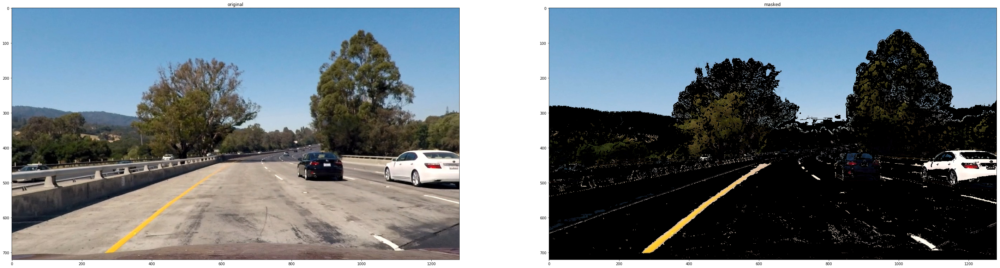

In [19]:
def get_sobel_and_color_mask(img: np.array) -> np.array:
    """Returns a combined Sobel mask and a color mask."""
    mask_sobel = get_all_sobel_masks(img)
    mask_color = get_color_mask(img)

    return cv2.bitwise_or(mask_sobel, mask_color)

def run_sobel_and_color_mask_example(img: np.array):
    masked_img = apply_mask(img, get_sobel_and_color_mask(img))
    show_side_to_side([(img, 'original'), (masked_img, 'masked')])

run_sobel_and_color_mask_example(undistorted_image)
masked_image = apply_mask(undistorted_image, get_sobel_and_color_mask(undistorted_image))

## Region of interest
We have successfully identified the edges we are interested at and some others like the sky. Now, the next step is to remove those edges we are not interested at by selecting a region of interest.

Our region of interest is going to consist of a isosceles trapezoid.

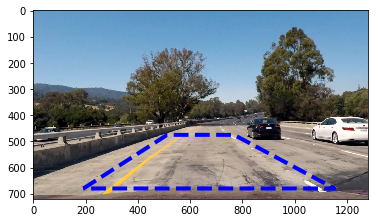

In [20]:
def get_vertices(shape: np.array) -> np.array:
    # The 40 pixels offset is to remove the image of the car at the bottom.
    return np.int32([[
        (shape[1] * 0.15, shape[0] - 40),  # Bottom left corner
        (shape[1] * 0.40, shape[0] * 0.66),  # Top left corner
        (shape[1] * 0.60, shape[0] * 0.66),  # Top right corner
        (shape[1] * 0.90, shape[0] - 40)]])  # Bottom right corner

def run_region_of_interest_example(img: np.array):
    t = get_vertices(img.shape).T
    plt.imshow(img)
    plt.plot(np.append(t[0], t[0][0]), np.append(t[1], t[1][0]), 'b--', lw=4)
    plt.show()

run_region_of_interest_example(undistorted_image)

## Perspective transform

The next step of the pipeline is the perspective transform. We need to create a bird's eyes view in order to determine if we are currently in a curve or a straight line.

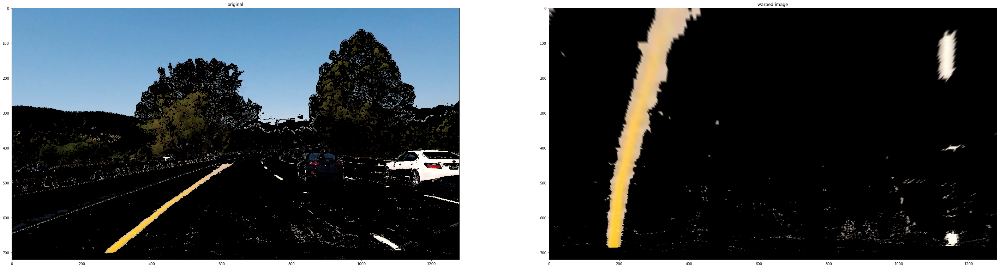

In [21]:
def perspective_transform(shape: np.array, offset: int=50) -> np.array:
    """Returns the perspective transform for the given shape."""
    # Let's get rid of additional channels.
    shape = shape[0:2]
    srcs = np.float32(get_vertices(shape))
    dest = np.float32([[offset, shape[0] - offset],
                       [offset, offset],
                       [shape[1] - offset, offset],
                       [shape[1] - offset, shape[0] - offset]])
    return cv2.getPerspectiveTransform(srcs, dest)

def warp(img: np.array, M: np.array) -> np.array:
    """Warps the perspective of the given image."""
    shape = img.shape
    return cv2.warpPerspective(img, M, (shape[1], shape[0]), flags=cv2.INTER_LINEAR)

def run_warp_example(img: np.array, M: np.array):
    warped_img = warp(img, M)
    show_side_to_side([(img, 'original'), (warped_img, 'warped image')])

perspective_mtx = perspective_transform(masked_image.shape)
warped_image = warp(masked_image, perspective_mtx)
run_warp_example(masked_image, perspective_mtx)

## Histograms

Let's take a histogram of the bottom section of the image in order to detect where the lane starts.

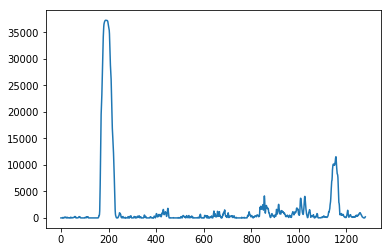

The left and right are located at (189, 1156) respectively.


In [22]:
def get_histogram(gray: np.array, bottom=0.3) -> np.array:
    """Returns a histogram of the bottom part of the gray image."""
    top_edge = int(gray.shape[0] * (1.0 - bottom))
    return np.sum(gray[top_edge:, :], axis=0)

def get_base(histogram: np.array) -> Tuple[np.int64, np.int64]:
    """Returns the x axis on the left and on the right, where the lanes start."""
    midpoint = np.int(histogram.shape[0] // 2)
    leftx = np.argmax(histogram[:midpoint])
    rightx = np.argmax(histogram[midpoint:]) + midpoint
    return (leftx, rightx)

def run_histogram_example(gray: np.array):
    plt.plot(get_histogram(gray))
    plt.show()

    print('The left and right are located at', get_base(get_histogram(gray)), 'respectively.')

gray_warped_image = to_gray(warped_image)
run_histogram_example(gray_warped_image)

## Find lane pixels

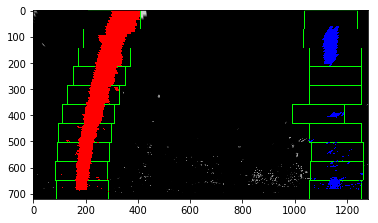

In [23]:
from typing import Optional

def find_lane_pixels_at_x(gray: np.array,
                          base_x: np.int64,
                          num_windows: int=10,
                          window_width: int=100,
                          min_num_pixels: int=50,
                          out_img: Optional[np.array]=None) -> np.array:
    """Finds the pixels associated to the lane that starts at `base_x`.

    Args:
        `num_windows`: number of sliding windows for each lane.
        `window_width`: width of each window in pixels (+/- window_width)
        `min_num_pixels`: minimum number of pixels needed to recenter window.
    """
    # Identify the x and y positions of all nonzero pixels in the image.
    nonzero = gray.nonzero()
    nonzero_y = np.array(nonzero[0])
    nonzero_x = np.array(nonzero[1])

    # Set height of windows - based on num_windows above and image shape.
    window_height = np.int(gray.shape[0] // num_windows)

    # All pixels that belong to the lane we are going to calculate in this function.
    lane_inds = []
    current_x = base_x
    for window in range(num_windows):
        # Let's find the window coordinates.
        lower_y = gray.shape[0] - (window + 1) * window_height
        upper_y = gray.shape[0] - window * window_height
        left_x = current_x - window_width
        right_x = current_x + window_width

        # Let's find the non-zero pixels in the current rectangle.
        good_inds = ((nonzero_x >= left_x) & (nonzero_x < right_x) &
                     (nonzero_y >= lower_y) & (nonzero_y < upper_y)).nonzero()[0]
        lane_inds.append(good_inds)

        # Let's recenter the lane if necessary.
        if len(good_inds) > min_num_pixels:
            current_x = int(np.mean(nonzero_x[good_inds], axis=0))

        # Let's draw the area we analyzed, if an image was specified.
        if out_img is not None:
            green_color = [0, 255, 0]
            cv2.rectangle(out_img, (left_x, lower_y), (right_x, upper_y), green_color, thickness=2)

    # Concatenate the arrays of indices (previously was a list of lists of pixels)
    lane_inds = np.concatenate(lane_inds)
    return np.array([nonzero_x[lane_inds], nonzero_y[lane_inds]])

def run_lanes_example(gray: np.array):
    out_img = np.dstack((gray, gray, gray))
    base_left_x, base_right_x = get_base(get_histogram(gray))

    # Find our lane pixels first
    left_x, left_y = find_lane_pixels_at_x(gray, base_left_x, out_img=out_img)
    right_x, right_y = find_lane_pixels_at_x(gray, base_right_x, out_img=out_img)
    # Left lane in red, right lane in blue.
    out_img[left_y, left_x] = [255, 0, 0]
    out_img[right_y, right_x] = [0, 0, 255]
    plt.imshow(out_img)

run_lanes_example(gray_warped_image)

## Fit polynomial for our left and right lanes

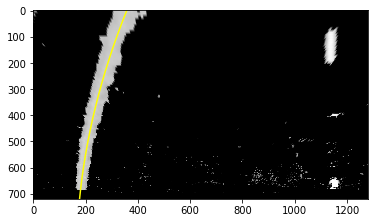

In [24]:
def fit_polynomial(x: np.array, y: np.array) -> np.array:
    """Fit a polynomial of second degree for the values specified."""
    return np.polyfit(y, y=x, deg=2)

def plot_lane_polynomial(fit: np.array, shape: np.array):
    # Generate y values for plotting purposes.
    plot_y = np.linspace(0, shape[0] - 1, num=shape[0])

    # Generate x values using the formula a * x ** 2 + b * x + c
    plot_x = fit[0] * plot_y ** 2 + fit[1] * plot_y + fit[2]

    plt.plot(plot_x, plot_y, color='yellow')

def run_polynomial_example(gray: np.array):
    out_img = np.dstack((gray, gray, gray))

    base_left_x, base_right_x = get_base(get_histogram(gray))
    left_x, left_y = find_lane_pixels_at_x(gray, base_left_x)
    left_fit = fit_polynomial(left_x, left_y)
    plot_lane_polynomial(left_fit, gray.shape)

    plt.imshow(out_img)
    plt.show()

run_polynomial_example(gray_warped_image)

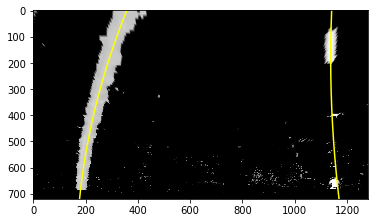

In [25]:
def find_lanes(gray: np.array, out_img: np.array=None) -> Tuple[np.array, np.array]:
    """Returns two polynomials for the left line and right line respectively."""
    base_left_x, base_right_x = get_base(get_histogram(gray))

    left_x, left_y = find_lane_pixels_at_x(gray, base_left_x, out_img=out_img)
    left_fit = fit_polynomial(left_x, left_y)

    right_x, right_y = find_lane_pixels_at_x(gray, base_right_x, out_img=out_img)
    right_fit = fit_polynomial(right_x, right_y)

    return (left_fit, right_fit)

def run_find_lanes_example(gray: np.array, left_fit: np.array, right_fit: np.array):
    out_img = np.dstack((gray, gray, gray))

    plot_lane_polynomial(left_fit, gray.shape)
    plot_lane_polynomial(right_fit, gray.shape)

    plt.imshow(out_img)
    plt.show()

left_fit, right_fit = find_lanes(gray_warped_image)
run_find_lanes_example(gray_warped_image, left_fit, right_fit)

## Measure curvature

The curvature of the polynomials that represent our lines can be calculated using:

f(y) = A * y <sup>2</sup> + B * y + C

R<sub>curve</sub>(y) = (1 + f'(y)<sup>2</sup>)<sup>3/2</sup>) / |f''(y)|

Where

f'(y) = 2 * A * y + B

f''(y) = 2 * A

Where all reduces to:

R<sub>curve</sub>(y) = (1 + (2 * A * y)<sup>2</sup>)<sup>3/2</sup>) / |2 * A|

In our particular case, we can use y = image.shape[0] in order to measure the curvature closest to the vehicle. However, it's worth mentioning, that the measurements we are getting are in pixels, and we need to transform that into real word units like meters. In order to accomplish that, we are going to use measurements of a lane in real life, and the size of our warped picture.

**y_meters_per_pixel = 30 / 720**

**x_meters_per_pixel = 3.7 / 700**

In [26]:
Y_METERS_PER_PIXEL = 30.0 / 720.0
X_METERS_PER_PIXEL = 3.7 / 700.0

def measure_curvature(fit: np.array, y_eval: np.int, plot_y: np.array) -> np.int:
    """Returns the curvature of a polynomial in real world units."""
    plot_x = fit[0] * plot_y ** 2 + fit[1] * plot_y + fit[2]

    # Fit another polynomial with real world units.
    fit_cr = fit_polynomial(plot_x * X_METERS_PER_PIXEL, plot_y * Y_METERS_PER_PIXEL)

    # Calculate the actual curvature.
    scaled_y_eval = y_eval * Y_METERS_PER_PIXEL
    return (1 + (2 * fit_cr[0] * scaled_y_eval + fit_cr[1]) ** 2) ** 1.5 / np.abs(2 * fit_cr[0])

def measure_lane_curvatures(left_fit: np.array, right_fit: np.array, shape: np.array) -> Tuple[np.int, np.int, np.int]:
    """Returns the curvatures of the left and right lines, and the center position of the car."""
    plot_y = np.linspace(0, shape[0] - 1, num=shape[0])
    y_eval = np.max(plot_y)

    left_curvature = measure_curvature(left_fit, y_eval, plot_y)
    right_curvature = measure_curvature(right_fit, y_eval, plot_y)
    bottom_left_x = left_fit[0] * y_eval ** 2 + left_fit[1] * y_eval + left_fit[2]
    bottom_right_x = right_fit[0] * y_eval ** 2 + right_fit[1] * y_eval + right_fit[2]
    fit_center_x = ((bottom_left_x + bottom_right_x) // 2) * X_METERS_PER_PIXEL

    real_center_x = (shape[1] // 2) * X_METERS_PER_PIXEL
    diff_x = fit_center_x - real_center_x
    return (left_curvature, right_curvature, diff_x)

def run_measure_lane_curvatures_example(left_fit: np.array, right_fit: np.array, shape: np.array):
    left_cr, right_cr, center = measure_lane_curvatures(left_fit, right_fit, shape)
    print('Left curvature is {:.2f}m'.format(left_cr))
    print('Right curvature is {:.2f}m'.format(right_cr))
    print('The car is {:.2f}m off center'.format(center))

run_measure_lane_curvatures_example(left_fit, right_fit, gray_warped_image.shape)

Left curvature is 780.68m
Right curvature is 1481.69m
The car is 0.17m off center


## Project our curvatures into the original image

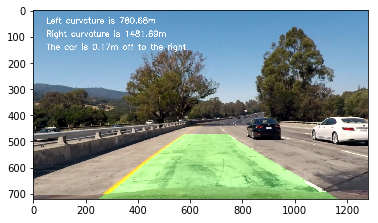

In [27]:
def project_curvatures(undistorted_img: np.array, Minv: np.array, left_fit: np.array, right_fit: np.array):
    """Returns an image that highlights the area between the left_fit and the right_fit."""
    # Create an image to draw the lines on.
    shape = undistorted_img.shape[:2]
    warp_zero = np.zeros(shape).astype(np.uint8)
    color_warp = np.dstack((warp_zero, warp_zero, warp_zero))

    # Recast the x and y points into usable format for cv2.fillPoly().
    plot_y = np.linspace(0, shape[0] - 1, num=shape[0])

    left_fitx = left_fit[0] * plot_y ** 2 + left_fit[1] * plot_y + left_fit[2]
    pts_left = np.array([np.transpose(np.vstack([left_fitx, plot_y]))])
    right_fitx = right_fit[0] * plot_y ** 2 + right_fit[1] * plot_y + right_fit[2]
    pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, plot_y])))])

    pts = np.hstack((pts_left, pts_right))

    # Draw the lane onto the warped blank image
    GREEN_COLOR = (0, 255, 0)
    cv2.fillPoly(color_warp, np.int_([pts]), GREEN_COLOR)

    # Warp the blank back to original image space using inverse perspective matrix (Minv).
    newwarp = cv2.warpPerspective(color_warp, Minv, (shape[1], shape[0]))

    # Let's add some text showing the line curvatures.
    left_cr, right_cr, center = measure_lane_curvatures(left_fit, right_fit, shape)

    WHITE_COLOR = (255, 255, 255)
    FONT = cv2.FONT_HERSHEY_SIMPLEX
    FONT_SIZE = 1
    FONT_THICKNESS = 2
    cv2.putText(undistorted_img, 'Left curvature is {:.2f}m'.format(left_cr), (50, 50), FONT, FONT_SIZE, WHITE_COLOR, FONT_THICKNESS, cv2.LINE_AA)
    cv2.putText(undistorted_img, 'Right curvature is {:.2f}m'.format(right_cr), (50, 100), FONT, FONT_SIZE, WHITE_COLOR, FONT_THICKNESS, cv2.LINE_AA)
    direction = 'left' if center < 0 else 'right'
    cv2.putText(undistorted_img, 'The car is {:.2f}m off to the {}'.format(abs(center), direction), (50, 150), FONT, FONT_SIZE, WHITE_COLOR, FONT_THICKNESS, cv2.LINE_AA)

    # Combine the result with the original image.
    return cv2.addWeighted(undistorted_img, 1, newwarp, 0.3, 0)

def run_project_curvature_example(undistorted_img: np.array, Minv: np.array, left_fit: np.array, right_fit: np.array):
    plt.imshow(project_curvatures(np.copy(undistorted_img), Minv, left_fit, right_fit))

perspective_inv_mtx = np.linalg.inv(perspective_mtx)
run_project_curvature_example(undistorted_image, perspective_inv_mtx, left_fit, right_fit)

## Run tests on a set of images
Let's see how our pipeline is performing so far.

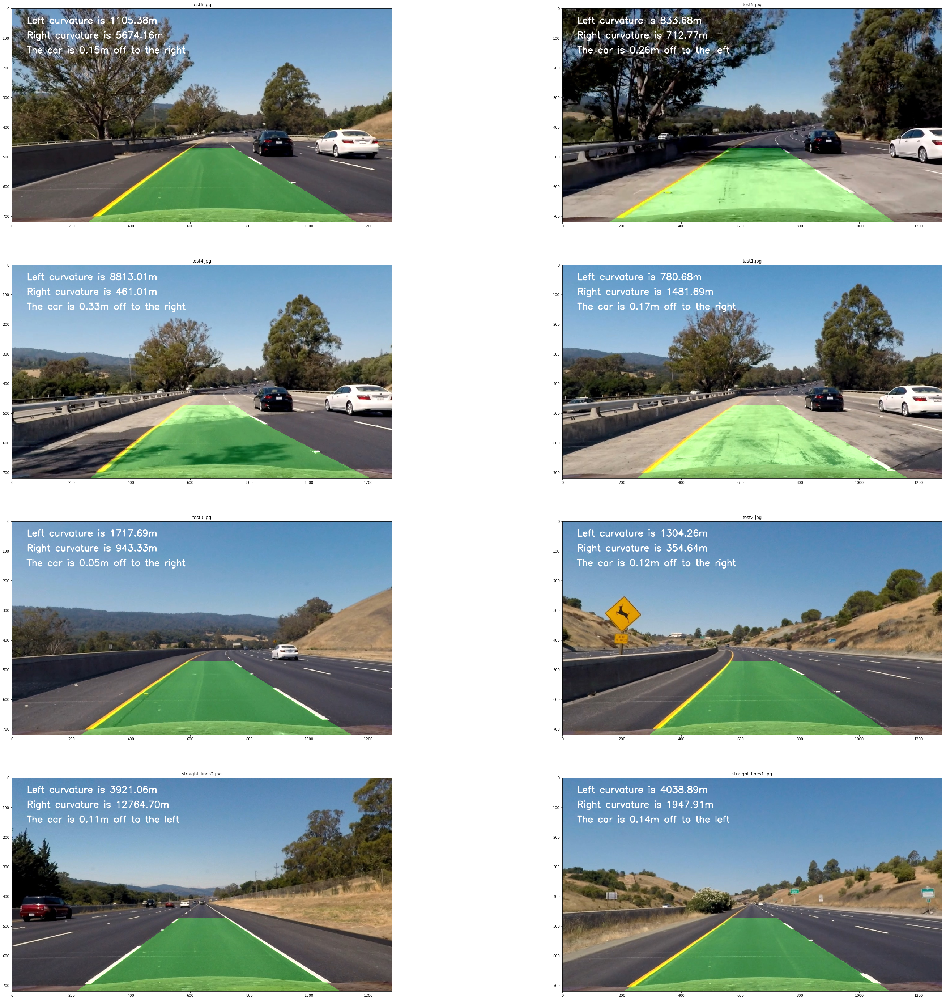

In [28]:
import math
import os
from typing import Callable

def process_image(img: np.array) -> np.array:
    """Processes the given image and hightlights the current lane."""
    undistorted_img = undistort(img, calibration_mtx, distortion_coefficients)
    warped_image = warp(apply_mask(undistorted_img, get_sobel_and_color_mask(undistorted_img)), perspective_mtx)
    gray_warped_image = to_gray(warped_image)

    left_fit, right_fit = find_lanes(gray_warped_image)
    return project_curvatures(undistorted_img, perspective_inv_mtx, left_fit, right_fit)

def run_on_images(input_dir: str, output_dir: str, cols: int=2) -> None:
    """Runs a given function over all images in `input_dir`."""
    image_filenames = os.listdir(input_dir)
    fig = plt.figure(figsize=(50, 50))
    rows = int(math.ceil(len(image_filenames) / float(cols)))
    for i, image_filename in enumerate(image_filenames):
        img = mpimg.imread(os.path.join(input_dir, image_filename))
        warped_image = process_image(img)

        output_filename = os.path.join(output_dir, image_filename)
        mpimg.imsave(output_filename, warped_image)

        subplot = fig.add_subplot(rows, cols, i + 1)
        subplot.title.set_text(image_filename)
        plt.imshow(warped_image)
    plt.show()

run_on_images('test_images', 'output_images')

Seems like our lane detection algorithm is working fine.

## Search from prior

Identifying lanes in a video is a bit expensive right now since we need to track lane lines for each frame where lines don't necessarily move a lot from frame to frame. In order to improve the efficiency of our approach, we are going to use the search from prior method, where we only consider pixels that are within of some margin of the previously identified lane lanes.

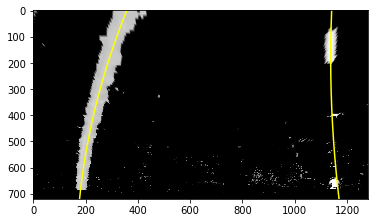

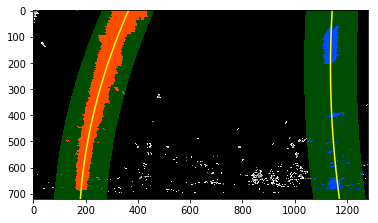

In [29]:
def search_single_line_from_prior(gray: np.array, plot_y: np.array, fit: np.array, margin: int=100) -> np.array:
    """Returns the new polynomial that represents the line in the given image using a previous fitted polynomial."""
    # Identify the x and y positions of all nonzero pixels in the image.
    shape = gray.shape

    nonzero = gray.nonzero()
    nonzero_y = np.array(nonzero[0])
    nonzero_x = np.array(nonzero[1])

    polynomial_eval = fit[0] * (nonzero_y ** 2) + fit[1] * nonzero_y + fit[2]
    lane_inds = ((nonzero_x > (polynomial_eval - margin)) & (nonzero_x < (polynomial_eval + margin))).nonzero()[0]
    x = nonzero_x[lane_inds]
    y = nonzero_y[lane_inds]

    return fit_polynomial(x, y)

def search_from_prior(gray: np.array, left_fit: np.array, right_fit: np.array, margin: int=100):
    """Searches the left and right lines using a previous fitted polynomial."""
    shape = gray.shape
    plot_y = np.linspace(0, shape[0] - 1, num=shape[0])
    new_left_fit = search_single_line_from_prior(gray, plot_y, left_fit, margin=margin)
    new_right_fit = search_single_line_from_prior(gray, plot_y, right_fit, margin=margin)
    return new_left_fit, new_right_fit

def run_search_from_prior_example(gray: np.array, left_fit: np.array, right_fit: np.array):
    shape = gray.shape
    MARGIN = 100
    plot_y = np.linspace(0, shape[0] - 1, num=shape[0])
    new_left_fit, new_right_fit = search_from_prior(gray, left_fit, right_fit, margin=MARGIN)

    left_x = new_left_fit[0] * plot_y ** 2 + new_left_fit[1] * plot_y + new_left_fit[2]
    right_x = new_right_fit[0] * plot_y ** 2 + new_right_fit[1] * plot_y + new_right_fit[2]

    ## Visualization ##
    # Create an image to draw on and an image to show the selection window
    out_img = np.dstack((gray, gray, gray)) * 255
    window_img = np.zeros_like(out_img)

    # Color in left and right line pixels
    nonzero = gray.nonzero()
    nonzero_y = np.array(nonzero[0])
    nonzero_x = np.array(nonzero[1])

    left_polynomial_eval = new_left_fit[0] * (nonzero_y ** 2) + new_left_fit[1] * nonzero_y + new_left_fit[2]
    left_lane_inds = ((nonzero_x > (left_polynomial_eval - MARGIN)) & (nonzero_x < (left_polynomial_eval + MARGIN))).nonzero()[0]
    RED_COLOR = (255, 0, 0)
    out_img[nonzero_y[left_lane_inds], nonzero_x[left_lane_inds]] = RED_COLOR

    right_polynomial_eval = new_right_fit[0] * (nonzero_y ** 2) + new_right_fit[1] * nonzero_y + new_right_fit[2]
    right_lane_inds = ((nonzero_x > (right_polynomial_eval - MARGIN)) & (nonzero_x < (right_polynomial_eval + MARGIN))).nonzero()[0]
    BLUE_COLOR = (0, 0, 255)
    out_img[nonzero_y[right_lane_inds], nonzero_x[right_lane_inds]] = BLUE_COLOR

    # Generate a polygon to illustrate the search window area
    # And recast the x and y points into usable format for cv2.fillPoly()
    left_line_window1 = np.array([np.transpose(np.vstack([left_x - MARGIN, plot_y]))])
    left_line_window2 = np.array([np.flipud(np.transpose(np.vstack([left_x + MARGIN, plot_y])))])
    left_line_pts = np.hstack((left_line_window1, left_line_window2))

    right_line_window1 = np.array([np.transpose(np.vstack([right_x - MARGIN, plot_y]))])
    right_line_window2 = np.array([np.flipud(np.transpose(np.vstack([right_x + MARGIN, plot_y])))])
    right_line_pts = np.hstack((right_line_window1, right_line_window2))

    # Draw the lane onto the warped blank image
    GREEN_COLOR = (0, 255, 0)
    cv2.fillPoly(window_img, np.int_([left_line_pts]), GREEN_COLOR)
    cv2.fillPoly(window_img, np.int_([right_line_pts]), GREEN_COLOR)
    result = cv2.addWeighted(out_img, 1, window_img, 0.3, 0)
    
    # Plot the polynomial lines onto the image
    plt.plot(left_x, plot_y, color='yellow')
    plt.plot(right_x, plot_y, color='yellow')
    plt.imshow(result)

left_fit, right_fit = find_lanes(gray_warped_image)
run_find_lanes_example(gray_warped_image, left_fit, right_fit)
run_search_from_prior_example(gray_warped_image, left_fit, right_fit)

As you can see, using the same fitted polynomials from a previous iteration works fine.

## Keeping track of previous frames

In [30]:
from collections import deque

class Line(object):
    """Class to receive the characteristics of each line detection."""

    def __init__(self, num_iterations: int, shape: np.array):
        """Initializes a Line object.

        Args:
            `num_iterations`: number of iterations we should be holding data for.
            `shape`: shape of the images we are working on.
        """
        # Set of y points we are working on.
        self._plot_y = np.linspace(0, shape[0] - 1, num=shape[0])

        # Polynomial coefficients for the last n successful iterations
        self._fits = deque(maxlen=num_iterations)

        # Average of the polynomial coefficients over the last n successful iterations.
        self._best_fit = None

    def fit(self) -> np.array:
        """Returns the best fit associated with the current line."""
        return self._best_fit

    def update_line(self, gray: np.array, base_x_hint: int) -> None:
        """Updates the current line using the new given frame.

        Args:
            `gray`: new frame in gray color space.
            `base_x_hint`: hint for where the line is located at.
        """
        # If this is the first frame we are analyzing, we should start with sliding windows.
        if self._best_fit is None:
            x, y = find_lane_pixels_at_x(gray, base_x_hint)
            fit = fit_polynomial(x, y)
            self._fits.append(fit)
            self._best_fit = fit
            return

        # We have a good candidate from previous frames, so let's use search from prior.
        new_fit = search_single_line_from_prior(gray, self._plot_y, self._best_fit)
        self._fits.append(new_fit)
        self._best_fit = np.mean(self._fits, axis=0)


PipelineParams = namedtuple('PipelineParams',
                            ['num_iterations',
                             'shape',
                             'calibration_matrix',
                             'distortion_coefficients',
                             'perspective_matrix',
                             'perspective_inverse_matrix'])

class Pipeline(object):
    """Pipeline for identifying the current lane in a given set of images."""
    def __init__(self, params: PipelineParams):
        self._params = params
        self._left_line = Line(params.num_iterations, params.shape)
        self._right_line = Line(params.num_iterations, params.shape)

    def process_image(self, img: np.array) -> np.array:
        """Returns an image with the projected curvature."""
        undistorted_img = undistort(img, self._params.calibration_matrix, self._params.distortion_coefficients)
        masked_image = apply_mask(undistorted_img, get_sobel_and_color_mask(undistorted_img))
        warped_image = warp(masked_image, self._params.perspective_matrix)
        gray_warped_image = to_gray(warped_image)

        self._detect_lines(gray_warped_image)
        left_fit = self._left_line.fit()
        right_fit = self._right_line.fit()
        return project_curvatures(undistorted_img, self._params.perspective_inverse_matrix, left_fit, right_fit)

    def _detect_lines(self, gray: np.array) -> None:
        """Updates the left and right lines using the new provided frame."""
        base_left_x, base_right_x = get_base(get_histogram(gray))

        self._left_line.update_line(gray, base_left_x)
        self._right_line.update_line(gray, base_right_x)

## Run tests on a set of videos

In [31]:
def process_video(challenge_input: str, challenge_output: str) -> None:
    NUM_ITERATIONS = 10
    params = PipelineParams(
        num_iterations=NUM_ITERATIONS,
        shape=(720, 1280, 3),
        calibration_matrix=calibration_mtx,
        distortion_coefficients=distortion_coefficients,
        perspective_matrix=perspective_mtx,
        perspective_inverse_matrix=perspective_inv_mtx)
    pipeline = Pipeline(params)

    clip = VideoFileClip(challenge_input)
    challenge_clip = clip.fl_image(pipeline.process_image)
    %time challenge_clip.write_videofile(challenge_output, audio=False)

    return HTML("""
    <video width="960" height="540" controls>
      <source src="{0}">
    </video>
    """.format(challenge_output))

In [33]:
process_video('test_videos/project_video.mp4', 'test_videos/output_project_video.mp4')

[MoviePy] >>>> Building video test_videos/output_project_video.mp4
[MoviePy] Writing video test_videos/output_project_video.mp4


100%|█████████▉| 1260/1261 [02:43<00:00,  7.99it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: test_videos/output_project_video.mp4 

CPU times: user 2min 37s, sys: 34.1 s, total: 3min 11s
Wall time: 2min 44s


As you can see, the lane is correctly identified.